In [14]:
import pandas as pd
import numpy as np

from google.oauth2 import service_account
from google.cloud import bigquery

import matplotlib.pyplot as plt
import matplotlib.dates as mdates 
import seaborn as sns
import pydeck as pdk

##### Bigquery에서 불러오기

In [15]:
SERVICE_ACCOUNT_FILE = "./bigquery_key/api_key.json"  # 키 json 파일
credentials = service_account.Credentials.from_service_account_file(SERVICE_ACCOUNT_FILE)
project_id = "driven-net-452904-q3"
dataset_name = "ecommerce_project"
client = bigquery.Client(credentials=credentials, project=project_id)

def import_bigquery_data(query):
    query_job = client.query(query)
    return query_job.to_dataframe()

In [16]:
query1 = (f"""select * from {project_id}.{dataset_name}.order_items""")
query2 = (f"""select * from {project_id}.{dataset_name}.orders""")
query3 = (f"""select * from {project_id}.{dataset_name}.payments""")
query4 = (f"""select * from {project_id}.{dataset_name}.products""")
query5 = (f"""select * from {project_id}.{dataset_name}.reviews""")
query6 = (f"""select * from {project_id}.{dataset_name}.geolocation""")
query7 = (f"""select * from {project_id}.{dataset_name}.customers""")
query8 = (f"""select * from {project_id}.{dataset_name}.sellers""")
query9 = (f"""select * from {project_id}.{dataset_name}.closed_deals""")
query10 = (f"""select * from {project_id}.{dataset_name}.mql""")


In [17]:
order_items = import_bigquery_data(query1)
orders = import_bigquery_data(query2)
payments = import_bigquery_data(query3)
products = import_bigquery_data(query4)
reviews = import_bigquery_data(query5)
geolocation = import_bigquery_data(query6)
customers = import_bigquery_data(query7)
sellers = import_bigquery_data(query8)
closed_deals_df = import_bigquery_data(query9)
mql_df = import_bigquery_data(query10)

### Analysis

##### 월별 주문수, 매출, 평균 주문 금액

In [18]:
order_merge = pd.merge(order_items,orders, how='inner', on='order_id')
order_merge = order_merge[~order_merge['order_status'].isin(['Canceled', 'unavailable'])]
order_merge['year'] = (order_merge['order_purchase_timestamp']).dt.year
order_merge['month'] = (order_merge['order_purchase_timestamp']).dt.month

order_merge = order_merge[order_merge['order_purchase_timestamp'].between("2017-01-01", "2018-08-31")]
order_merge


,order_id,count,product_id,price,freight_value,revenue,customer_id,order_status,order_purchase_timestamp,year,month
0,3ee6513ae7ea23bdfab5b9ab60bffcb5,1,8a3254bee785a526d548a81a9bc3c9be,0.85,18.23,19.08,161b6d415e8b3413c6609c70cf405b5a,delivered,2018-04-24 11:01:06,2018,4
1,6e864b3f0ec71031117ad4cf46b7f2a1,1,8a3254bee785a526d548a81a9bc3c9be,0.85,18.23,19.08,9f9d249355f63c5c1216a82b802452c1,delivered,2018-04-24 20:15:21,2018,4
2,c5bdd8ef3c0ec420232e668302179113,2,8a3254bee785a526d548a81a9bc3c9be,0.85,22.30,46.30,5af78bf1a82a2660d1e3fd78c645f58f,delivered,2018-04-27 12:37:10,2018,4
3,c5bdd8ef3c0ec420232e668302179113,1,134957eeec87be2414ac629ee0b947a4,19.90,11.15,31.05,5af78bf1a82a2660d1e3fd78c645f58f,delivered,2018-04-27 12:37:10,2018,4
4,8272b63d03f5f79c56e9e4120aec44ef,1,270516a3f41dc035aa87d220228f844c,1.20,7.89,9.09,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017,7
...,...,...,...,...,...,...,...,...,...,...,...
112645,199af31afc78c699f0dbf71fb178d4d4,1,c3ed642d592594bb648ff4a04cee2747,4690.00,74.34,4764.34,24bbf5fd2f2e1b359ee7de94defc4a15,delivered,2017-04-18 18:50:13,2017,4
112646,a96610ab360d42a2e5335a3998b4718a,1,a6492cc69376c469ab6f61d8f44de961,4799.00,151.34,4950.34,df55c14d1476a9a3467f131269c2477f,delivered,2017-04-01 15:58:40,2017,4
112647,f5136e38d1a14a4dbd87dff67da82701,1,1bdf5e6731585cf01aa8169c7028d6ad,6499.00,227.66,6726.66,3fd6777bbce08a352fddd04e4a7cc8f6,delivered,2017-05-24 18:14:34,2017,5
112648,fefacc66af859508bf1a7934eab1e97f,1,69c590f7ffc7bf8db97190b6cb6ed62e,6729.00,193.21,6922.21,f48d464a0baaea338cb25f816991ab1f,delivered,2018-07-25 18:10:17,2018,7


In [19]:
# 월별로 주문한 고유 주문수
result1 = pd.merge(
order_merge.groupby(['year', 'month'])['order_id'].nunique().reset_index(),
order_merge.groupby(['year','month'])['revenue'].sum().reset_index(),
how='inner',
on=['year', 'month'])
result1.columns = ['year','month', 'order_cnt', 'revenue']
# aov(평균 주문 금액) 계산
result1['aov']=round(result1["revenue"]/result1['order_cnt'])
# 2016년 데이터와, 2018년 9월 데이터가 정상적인 데이터가 아닌 것으로 보임
# 따라서 제외해주겠음
result1.head(5)

,year,month,order_cnt,revenue,aov
0,2017,1,789,162277.38,206.0
1,2017,2,1733,314813.91,182.0
2,2017,3,2641,479757.49,182.0
3,2017,4,2391,458929.07,192.0
4,2017,5,3660,654151.39,179.0


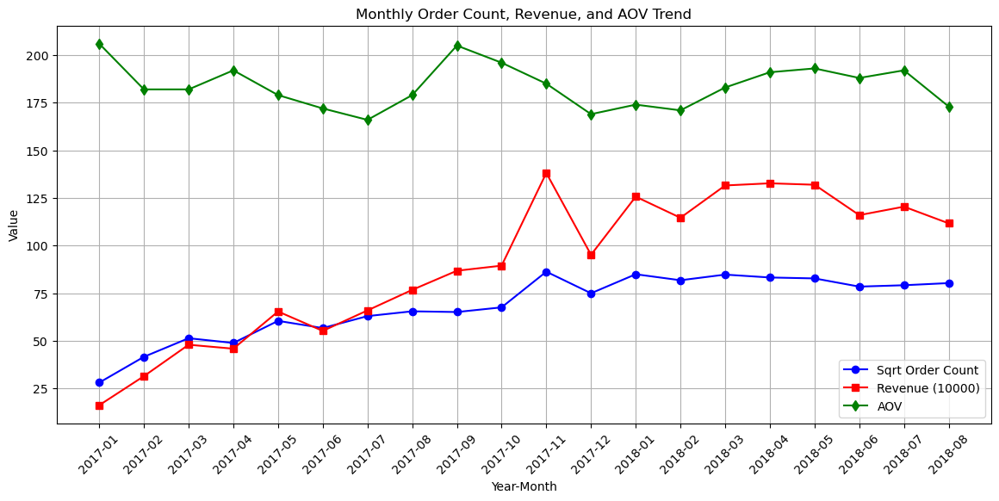

In [20]:
# year와 month를 문자열로 결합하여 x축 레이블 생성
result1["year_month"] = result1["year"].astype(str) + "-" + result1["month"].astype(str).str.zfill(2)

#회원수 조정
result1['sqrt_order_cnt'] = np.sqrt(result1['order_cnt'])

# 그래프 크기 설정
plt.figure(figsize=(14, 6))

# 주문 건수 (Order Count)
plt.plot(result1["year_month"], result1["sqrt_order_cnt"], marker="o", linestyle="-", label="Sqrt Order Count", color="blue")

# 매출 (Revenue) - 10,000 단위로 스케일 조정
plt.plot(result1["year_month"], result1["revenue"] / 10000, marker="s", linestyle="-", label="Revenue (10000)", color="red")

# AOV (Average Order Value)
plt.plot(result1["year_month"], result1["aov"], marker="d", linestyle="-", label="AOV", color="green")

# x축 라벨 회전
plt.xticks(rotation=45)

# 축 및 제목 설정
plt.xlabel("Year-Month")
plt.ylabel("Value")
plt.title("Monthly Order Count, Revenue, and AOV Trend")
plt.legend()
plt.grid(True)
plt.show()

##### seller, buyer 도시 분포

In [21]:
# 도시별 분포
customer_seller_merge = pd.merge(
customers.groupby(['customer_zip_code_prefix'])[["customer_id"]].nunique().reset_index().sort_values(by="customer_id"),
sellers.groupby(['seller_zip_code_prefix'])[["seller_id"]].nunique().sort_values(by="seller_id"),
how='inner',
left_on='customer_zip_code_prefix',
right_on='seller_zip_code_prefix'
)
customer_seller_merge.rename(columns={'customer_zip_code_prefix':'geolocation_zip_code_prefix'}, inplace=True)
geo_sell_buy_merge = pd.merge(geolocation, customer_seller_merge, how="inner", on='geolocation_zip_code_prefix')

In [22]:
# 고객 수, 판매자 수에 따라 색상을 다르게 지정
customer_layer = pdk.Layer(
    "ScatterplotLayer",
    geo_sell_buy_merge,
    get_position=["geolocation_lng", "geolocation_lat"],
    get_radius="customer_id * 500",
    get_fill_color="[0, 255, 0, 160]",  # 하늘색 (RGBA)
    pickable=True,
    opacity=0.6,
)

seller_layer = pdk.Layer(
    "ScatterplotLayer",
    geo_sell_buy_merge,
    get_position=["geolocation_lng", "geolocation_lat"],
    get_radius="seller_id * 500",
    get_fill_color="[255, 0, 255, 255]",  # 빨간색 (RGBA)
    pickable=True,
    opacity=0.6,
)

# Pydeck 뷰 설정
view_state = pdk.ViewState(
    latitude=geo_sell_buy_merge["geolocation_lat"].mean(),
    longitude=geo_sell_buy_merge["geolocation_lng"].mean(),
    zoom=5,
    pitch=0,
)

# Pydeck 맵 생성
r = pdk.Deck(
    layers=[customer_layer, seller_layer],
    initial_view_state=view_state,
    tooltip={"text": "City: {geolocation_city}\nCustomers: {customer_id}\nSellers: {seller_id}"},
)

# 맵 표시
r.show()

##### 카테고리별 구매 수, 카테고리별 구매 금액

In [23]:
order_product_merge = pd.merge(order_merge, products, how='inner', on='product_id')
cat_ord_rev= pd.merge(
order_product_merge.groupby(['product_category_name'])['order_id'].nunique().reset_index().sort_values(by='order_id', ascending=False),
order_product_merge.groupby(['product_category_name'])['revenue'].sum().reset_index().sort_values(by='revenue', ascending=False),
how='inner', on=['product_category_name']
)
cat_ord_rev.columns=['category','order_cnt','total_revenue']
cat_ord_rev = cat_ord_rev.sort_values(by=['total_revenue'], ascending=False)

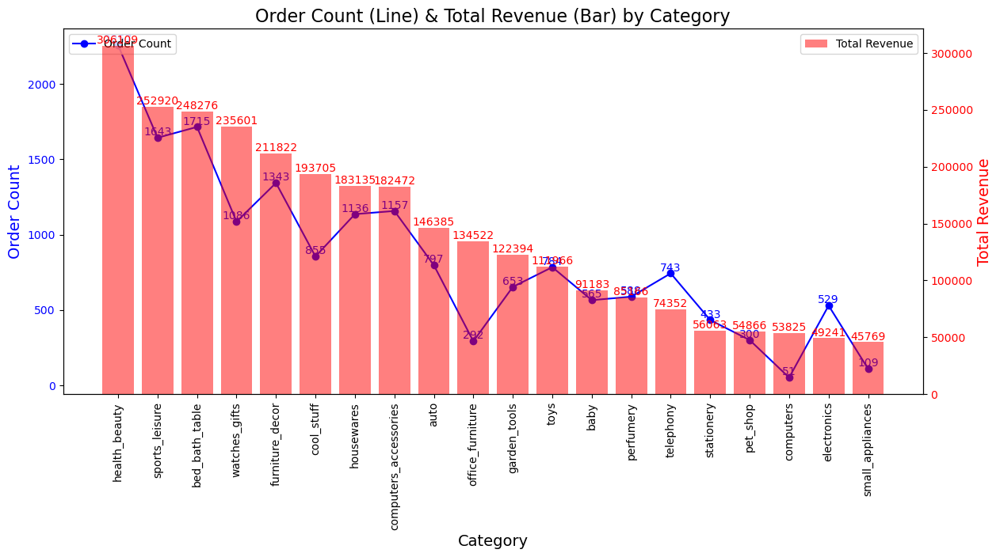

In [24]:
top_20_revenue_per_category = cat_ord_rev[:20].sort_values(by='total_revenue',ascending=False)

# 그래프 크기 설정
fig, ax1 = plt.subplots(figsize=(14, 6))

# 첫 번째 y축 (order_cnt, 라인 그래프)
ax1.set_xlabel("Category", fontsize=14)
ax1.set_ylabel("Order Count", color="blue", fontsize=14)
line_plot = ax1.plot(top_20_revenue_per_category["category"], top_20_revenue_per_category["order_cnt"], marker="o", linestyle="-", color="blue", label="Order Count", zorder=2)
ax1.tick_params(axis="y", labelcolor="blue")

# 라인 그래프 위에 수치 라벨 추가
for i, txt in enumerate(top_20_revenue_per_category["order_cnt"]):
    ax1.annotate(f"{txt}", (i, top_20_revenue_per_category["order_cnt"].iloc[i]), ha='center', va='bottom', fontsize=10, color="blue")

# x축 회전 (가독성 향상)
plt.xticks(rotation=90)

# 두 번째 y축 (total_revenue, 막대 그래프)
ax2 = ax1.twinx()
ax2.set_ylabel("Total Revenue", color="red", fontsize=14)
bar_plot = ax2.bar(top_20_revenue_per_category["category"], top_20_revenue_per_category["total_revenue"], color="red", alpha=0.5, label="Total Revenue", zorder=1)
ax2.tick_params(axis="y", labelcolor="red")

# 막대 그래프 위에 수치 라벨 추가
for bar in bar_plot:
    height = bar.get_height()
    ax2.annotate(f"{int(height)}", 
                 (bar.get_x() + bar.get_width() / 2., height), 
                 ha='center', va='bottom', fontsize=10, color="red")

# 그래프 제목 설정
plt.title("Order Count (Line) & Total Revenue (Bar) by Category", fontsize=16)

# 범례 추가
ax1.legend(loc="upper left")
ax2.legend(loc="upper right")

# 그래프 출력
plt.show()

In [25]:
# 2차 구매율

order_product_merge1 = order_product_merge
order_product_merge1['customer_counts'] = order_product_merge1['customer_id'].map(
    order_product_merge1['customer_id'].value_counts()
)

multi_order = order_product_merge1[order_product_merge1['customer_counts'] >= 2]

a_df = multi_order.groupby('product_category_name')['order_id'].nunique().reset_index()
b_df = order_product_merge.groupby('product_category_name')['order_id'].nunique().reset_index()
a_df.columns = ['category', 'counts_over_2']
b_df.columns = ['category', 'counts']
multi_sales_count = pd.merge(a_df,b_df,how='inner', on='category')

multi_sales_count['multi_sales_rate'] = round(multi_sales_count['counts_over_2'] / multi_sales_count['counts'],4) * 100
multi_sales_count
multi_sales_count = multi_sales_count[['category','multi_sales_rate']].sort_values(by='multi_sales_rate', ascending= False)
multi_sales_count.columns = ['category', 'resales_rate']
multi_sales_count = multi_sales_count.head(10)
multi_sales_count

,category,resales_rate
39,office_furniture,23.63
33,industry_commerce_and_business,21.95
24,food_drink,18.37
16,costruction_tools_garden,18.00
28,garden_tools,17.92
42,signaling_and_security,17.86
27,furniture_living_room,15.00
26,furniture_decor,14.15
46,tablets_printing_image,13.33
37,music,12.50


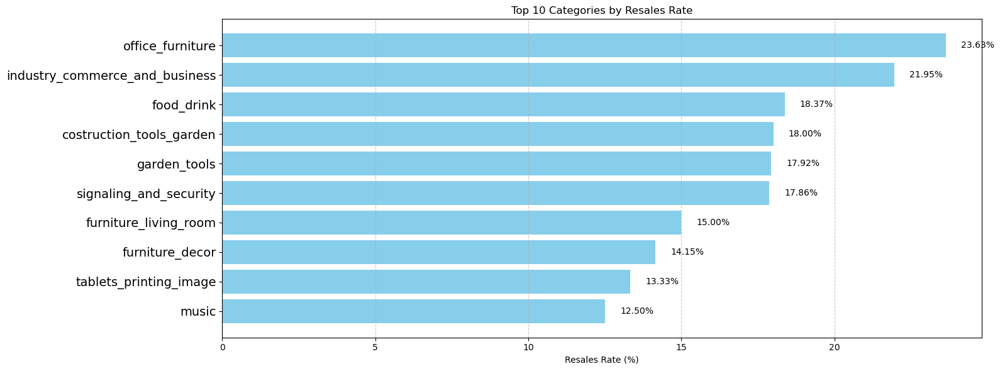

In [26]:
# 시각화 대상: 상위 10개 카테고리
top10 = multi_sales_count.sort_values('resales_rate', ascending=False).head(10)

# 그래프 크기 설정
plt.figure(figsize=(16, 6))

# 막대그래프 그리기
plt.barh(top10['category'], top10['resales_rate'], color='skyblue')
plt.xlabel('Resales Rate (%)')
plt.title('Top 10 Categories by Resales Rate')
plt.yticks(fontsize=14)
plt.gca().invert_yaxis()  # 높은 값이 위로 오도록 y축 뒤집기
plt.grid(axis='x', linestyle='--', alpha=0.7)

# 수치 라벨 표시
for index, value in enumerate(top10['resales_rate']):
    plt.text(value + 0.5, index, f'{value:.2f}%', va='center')

plt.tight_layout()
plt.show()

##### 리뷰데이터 평균 평점

In [27]:
# 평균 평점
review_merge = pd.merge(reviews, order_product_merge, how='right', on='order_id').reset_index()
review_merge = review_merge[review_merge['review_score'].notnull()]
mean_review_score_per_category = review_merge.groupby('product_category_name')['review_score'].mean().reset_index().sort_values("review_score", ascending=False)
# review_score 기준으로 그룹화 후, product_category_name을 쉼표로 연결
grouped = mean_review_score_per_category.groupby('review_score')['product_category_name'] \
    .apply(lambda x: ', '.join(x)).reset_index()
# 보기 좋게 컬럼 이름 바꾸기
grouped.columns = ['review_score', 'categories']
# 점수 높은 순으로 정렬
grouped = grouped.sort_values('review_score', ascending=False)


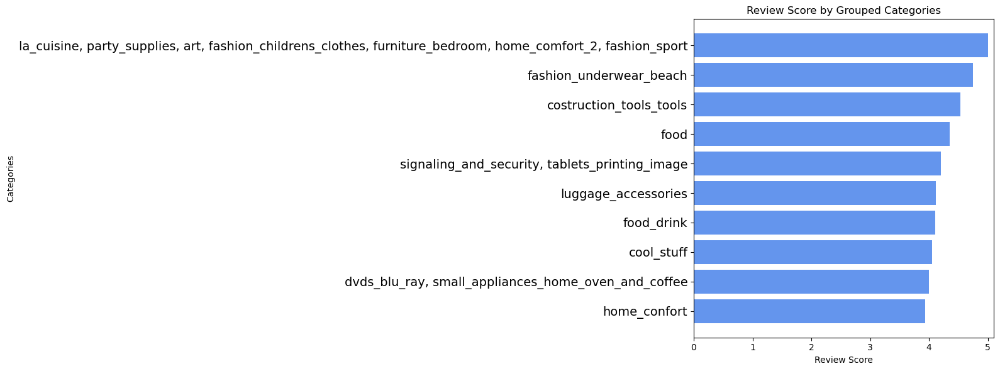

In [28]:
grouped_vis = grouped.sort_values('review_score', ascending=False).head(10)

plt.figure(figsize=(16, 6))

plt.barh(grouped_vis['categories'], grouped_vis['review_score'], color='cornflowerblue')

plt.xlabel('Review Score')
plt.ylabel('Categories')
plt.title('Review Score by Grouped Categories')

plt.xlim(0, 5.1)
plt.yticks(fontsize=14)
plt.gca().invert_yaxis()

plt.tight_layout()

plt.show()

##### 월별 카테고리 구매 수, 월별 카테고리별 구매 금액

In [29]:
category_order_revenue= pd.merge(
order_product_merge.groupby(['product_category_name','year','month'])['order_id'].nunique().reset_index().sort_values(by='order_id', ascending=False),
order_product_merge.groupby(['product_category_name','year','month'])['revenue'].sum().reset_index().sort_values(by='revenue', ascending=False),
how='inner', on=['product_category_name','year','month']
)
category_order_revenue.columns=[['category','year','month','order_cnt','total_revenue']]
# MultiIndex를 단일 컬럼으로 변환
category_order_revenue.columns = category_order_revenue.columns.get_level_values(0)  
#year과 month 기준으로 재정렬
category_order_revenue = category_order_revenue.sort_values(by=['year','month','category'])

# aov(평균 주문 금액) 계산
category_order_revenue['aov']=round(category_order_revenue["total_revenue"]/category_order_revenue['order_cnt'])
category_order_revenue


,category,year,month,order_cnt,total_revenue,aov
797,air_conditioning,2017,1,1,192.90,193.0
490,auto,2017,1,6,2779.89,463.0
443,baby,2017,1,7,2273.01,325.0
522,bed_bath_table,2017,1,5,778.49,156.0
525,computers_accessories,2017,1,5,244.69,49.0
...,...,...,...,...,...,...
44,sports_leisure,2018,8,94,13247.12,141.0
201,stationery,2018,8,32,3859.57,121.0
167,telephony,2018,8,39,5255.92,135.0
199,toys,2018,8,33,4418.48,134.0


In [30]:
# 각 카테고리별 매출 변화를 회귀 분석을 통해 추세선 기울기 계산
trend_slopes = {}

# category를 series로 추출
categories = category_order_revenue["category"].squeeze()  # 혹시 숫자로 저장되어 있다면 문자열로 변환
categories = categories.unique()  # 고유한 카테고리 리스트 가져오기

for category in categories:
    subset = category_order_revenue[category_order_revenue["category"] == category].sort_values(by=["year", "month"])
    x = np.arange(len(subset))  # 시간순서 인덱스 (0, 1, 2, ...)
    y = subset["total_revenue"].values  # 매출 데이터
    
    if len(y) > 1:  # 데이터가 2개 이상일 때만 회귀 분석 수행
        slope, intercept = np.polyfit(x, y, 1)  # 1차 다항 회귀 (선형 회귀)
        trend_slopes[category] = slope

# 기울기 데이터를 DataFrame으로 변환
trend_slopes_df = pd.DataFrame(trend_slopes.items(), columns=["category", "slope"]).sort_values(by="slope", ascending=False)

# 상위 5개 기울기 (매출 증가 추세)
top_5_trend = trend_slopes_df.nlargest(5, "slope")

# 하위 5개 기울기 (매출 감소 추세)
bottom_5_trend = trend_slopes_df.nsmallest(5, "slope")

# 상위 하위 5개씩 list로 추출
top_5_cat = top_5_trend['category'].tolist()
bottom_5_cat = bottom_5_trend['category'].tolist()


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_15780\627548005.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(subset["year_month"], rotation=45)


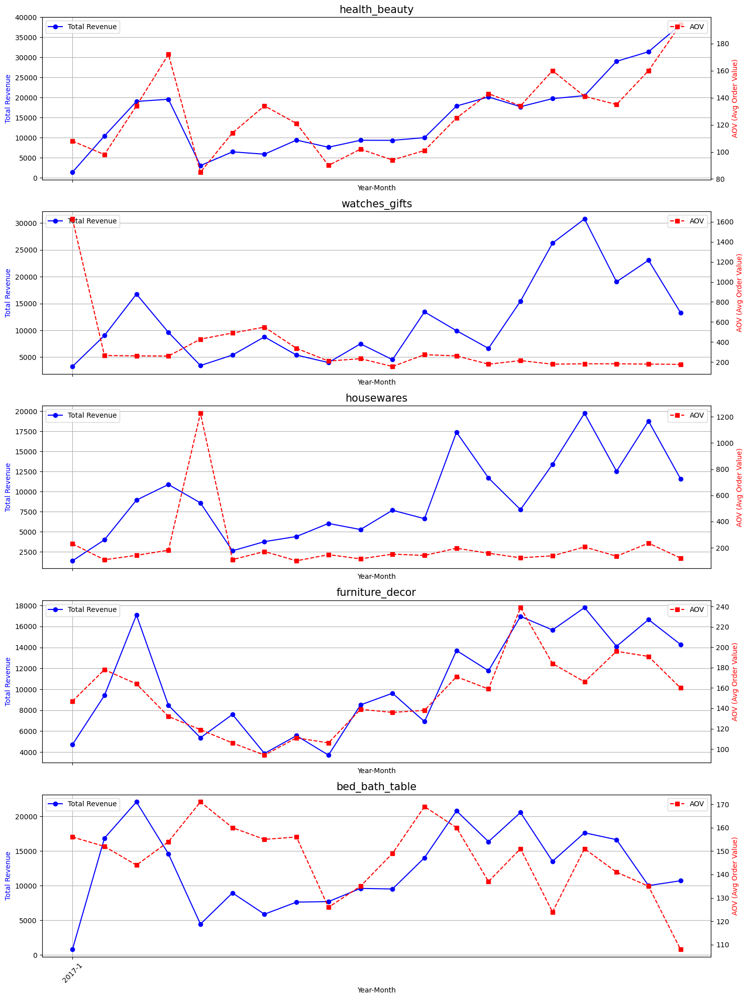

In [31]:
# 상위 5개 카테고리 필터링
selected_categories = top_5_cat
filtered_df = category_order_revenue[category_order_revenue["category"].isin(selected_categories)].copy()
filtered_df["year_month"] = filtered_df["year"].astype(str) + "-" + filtered_df["month"].astype(str)

# Subplot 설정
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(15, 20), sharex=True)
axes = axes.flatten()  # 2D 배열을 1D 배열로 변환

# 카테고리별로 그래프 그리기
for i, category in enumerate(selected_categories):
    subset = filtered_df[filtered_df["category"] == category].sort_values(by=["year_month"])  # 시간순 정렬

    ax = axes[i]
    ax2 = ax.twinx()  # 두 번째 y축 생성

    # 매출 라인 그래프 (시간순 정렬)
    ax.plot(subset["year_month"], subset["total_revenue"], marker='o', color='b', linestyle='-', label="Total Revenue")

    # AOV 라인 그래프 (시간순 정렬, 두 번째 y축)
    ax2.plot(subset["year_month"], subset["aov"], marker='s', linestyle='--', color='r', label="AOV")

    # 제목 및 축 레이블
    ax.set_title(f"{category}", fontsize=15)
    ax.set_xlabel("Year-Month")
    ax.set_ylabel("Total Revenue", color='b')
    ax2.set_ylabel("AOV (Avg Order Value)", color='r')

    # X축을 날짜 포맷으로 설정하여 연도-월이 표시되도록 함
    ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))  # 1개월 간격으로 표시
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))  # 날짜 형식 지정
    ax.set_xticklabels(subset["year_month"], rotation=45)

    # 범례 추가
    ax.legend(loc="upper left")
    ax2.legend(loc="upper right")

    ax.grid(True)

# 전체 레이아웃 조정
plt.tight_layout()
plt.show()

C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_15780\3194974208.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(subset["year_month"], rotation=45)


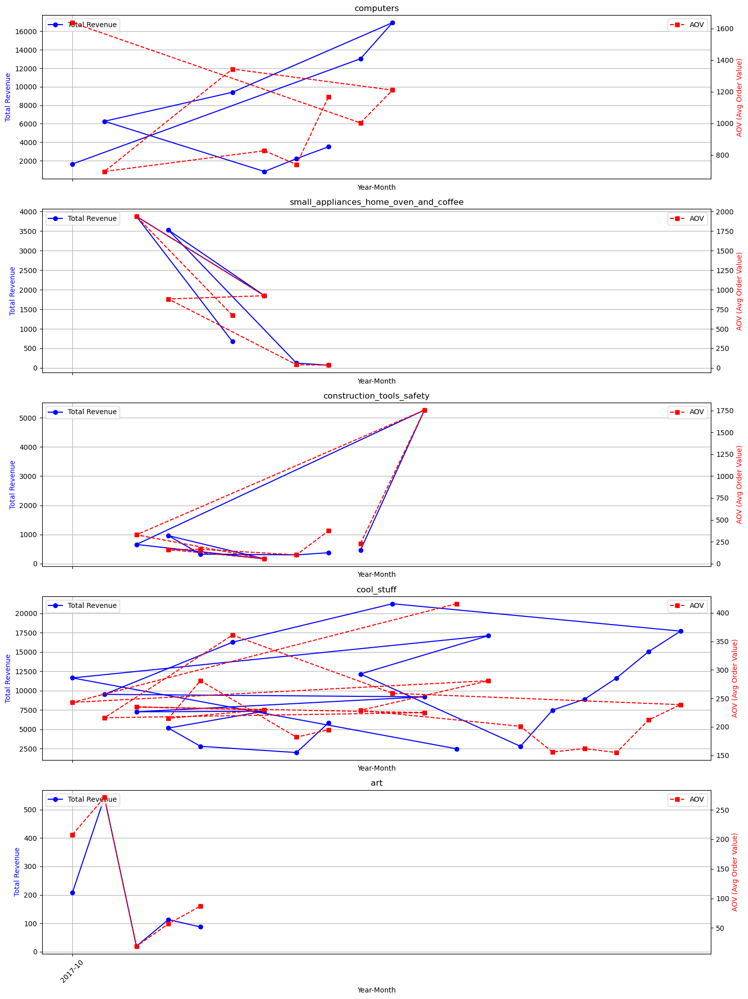

In [32]:
# 상위 5개 카테고리 필터링
selected_categories = bottom_5_cat
filtered_df = category_order_revenue[category_order_revenue["category"].isin(selected_categories)].copy()
filtered_df["year_month"] = filtered_df["year"].astype(str) + "-" + filtered_df["month"].astype(str)

# Subplot 설정
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(15, 20), sharex=True)
axes = axes.flatten()  # 2D 배열을 1D 배열로 변환

# 카테고리별로 그래프 그리기
for i, category in enumerate(selected_categories):
    subset = filtered_df[filtered_df["category"] == category].sort_values(by=["year_month"])  # 시간순 정렬

    ax = axes[i]
    ax2 = ax.twinx()  # 두 번째 y축 생성

    # 매출 라인 그래프 (시간순 정렬)
    ax.plot(subset["year_month"], subset["total_revenue"], marker='o', color='b', linestyle='-', label="Total Revenue")

    # AOV 라인 그래프 (시간순 정렬, 두 번째 y축)
    ax2.plot(subset["year_month"], subset["aov"], marker='s', linestyle='--', color='r', label="AOV")

    # 제목 및 축 레이블
    ax.set_title(f"{category}", fontsize=12)
    ax.set_xlabel("Year-Month")
    ax.set_ylabel("Total Revenue", color='b')
    ax2.set_ylabel("AOV (Avg Order Value)", color='r')

    # X축을 날짜 포맷으로 설정하여 연도-월이 표시되도록 함
    ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))  # 1개월 간격으로 표시
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))  # 날짜 형식 지정
    ax.set_xticklabels(subset["year_month"], rotation=45)

    # 범례 추가
    ax.legend(loc="upper left")
    ax2.legend(loc="upper right")

    ax.grid(True)

# 전체 레이아웃 조정
plt.tight_layout()
plt.show()


##### churn rate & LTV

In [33]:
orders['year'] = (orders['order_purchase_timestamp']).dt.year
orders['month'] = (orders['order_purchase_timestamp']).dt.month
orders["year_month"] = orders["year"].astype(str) + "-" + orders["month"].astype(str)

In [34]:
orders1 = orders
churn_df = orders1[orders1['order_status'].isin(['canceled','unavailable'])]

In [35]:
total_churn_cnt = pd.merge(
    orders1.groupby("year_month")[['customer_id']].nunique().reset_index(),
    churn_df.groupby("year_month")['customer_id'].nunique().reset_index(),
    how = "inner",
    on='year_month'
)
total_churn_cnt.columns = ['year_month','total','churn_cnt']
total_churn_cnt['year_month'] = pd.to_datetime(total_churn_cnt['year_month'])

#churn rate 계산
total_churn_cnt['churn_rate'] = total_churn_cnt['churn_cnt'] / total_churn_cnt['total']
total_churn_cnt['LTV'] = 1 / total_churn_cnt['churn_cnt']
total_churn_cnt = total_churn_cnt[total_churn_cnt['year_month'].between("2017-01", "2018-08")].sort_values(by='year_month')


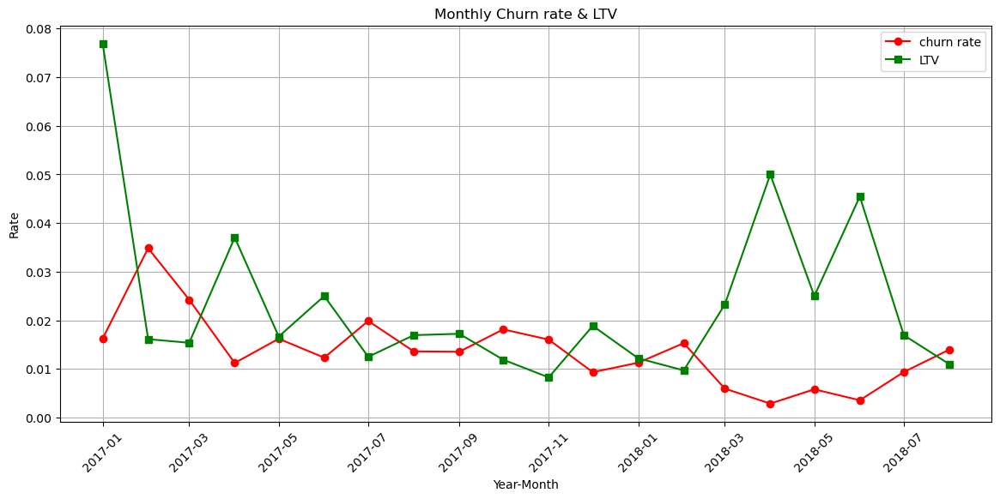

In [36]:
# 그래프 크기 설정
plt.figure(figsize=(14, 6))

# 주문 건수 (Order Count)
plt.plot(total_churn_cnt["year_month"], total_churn_cnt["churn_rate"], marker="o", linestyle="-", label="churn rate", color="red")

# 매출 (Revenue) - 10,000 단위로 스케일 조정
plt.plot(total_churn_cnt["year_month"], total_churn_cnt["LTV"], marker="s", linestyle="-", label="LTV", color="green")

# x축 라벨 회전
plt.xticks(rotation=45)

# 축 및 제목 설정
plt.xlabel("Year-Month")
plt.ylabel("Rate")
plt.title("Monthly Churn rate & LTV")
plt.legend()
plt.grid(True)
plt.show()